이 파일에서는 안테나 Plot까지만 진행합니다.

In [1]:
# 이 블록은 원본에는 존재하지 않는 부분입니다.

import sys
import os

# 경로 추가
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '../..')))

In [2]:
import os

gpu_num = ""  # Use "" to use the CPU
os.environ["CUDA_VISIBLE_DEVICES"] = f"{gpu_num}"
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"

# Colab does currently not support the latest version of ipython.
# Thus, the preview does not work in Colab. However, whenever possible we
# strongly recommend to use the scene preview mode.
try:  # detect if the notebook runs in Colab
    import google.colab

    colab_compat = True  # deactivate preview
except:
    colab_compat = False

# Allows to exit cell execution in Jupyter
class ExitCell(Exception):
    def _render_traceback_(self):
        pass

import mitsuba as mi
mi.set_variant("llvm_ad_rgb")

# Import Sionna
try:
    import sionna
except ImportError as e:
    # Install Sionna if package is not already installed
    import os

    os.system("pip install sionna")
    import sionna

# Configure the notebook to use only a single GPU and allocate only as much memory as needed
# For more details, see https://www.tensorflow.org/guide/gpu
import tensorflow as tf

gpus = tf.config.list_physical_devices("GPU")
if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
    except RuntimeError as e:
        print(e)
# Avoid warnings from TensorFlow
tf.get_logger().setLevel("ERROR")

tf.random.set_seed(
    1
)  # Set global random seed for reproducibility

In [3]:
# Import Sionna RT components
import geopandas as gpd
import numpy as np
import numpy.typing
from sionna.rt import load_scene, Transmitter, Receiver, PlanarArray, Camera

from src.classes.BostonTwin import BostonTwin
from pathlib import Path

import geopandas as gpd
import numpy as np
import numpy.typing


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


# BostonTwin

BostonTwin is a dataset that merges a high-fidelity 3D model of the city of Boston, MA, with the existing geospatial data on cellular base stations deployments, in a ray-tracing-ready format. Thus, BostonTwin enables not only the instantaneous rendering and programmatic access to the building models, but it also allows for an accurate representation of the electromagnetic propagation environment in the real-world city of Boston.

## Quickstart

### Initialize and visualize BostonTwin

Create the BostonTwin object by specifying the path of the dataset. The dataset can be downloaded from <http://hdl.handle.net/2047/D20623157>.

In [4]:
# 이 블록은 원본에는 존재하지 않는 부분입니다.

dataset_dir = Path("../../bostontwin/bostontwin")
dataset_dir

PosixPath('../../bostontwin/bostontwin')

In [5]:
# 이 블록은 원본과 다른 변경된 부분입니다.

# dataset_dir = Path("bostontwin")
bostwin = BostonTwin(dataset_dir)

31 scenes imported.


We can get a list of currently available scenes through the `get_scene_names` method.

In [6]:
scene_names = bostwin.get_scene_names()

scene_names.sort()

print(f"There are {len(scene_names)} scenes available in {dataset_dir}.\n{scene_names}")

There are 31 scenes available in ../../bostontwin/bostontwin.
['BOS_F_4', 'BOS_F_5', 'BOS_F_6', 'BOS_F_7', 'BOS_F_8', 'BOS_F_9', 'BOS_G_3', 'BOS_G_4', 'BOS_G_5', 'BOS_G_6', 'BOS_G_7', 'BOS_G_8', 'BOS_G_9', 'BOS_H_3', 'BOS_H_4', 'BOS_H_5', 'BOS_H_6', 'BOS_H_7', 'BOS_H_8', 'BOS_H_9', 'BOS_I_3', 'BOS_I_4', 'BOS_I_5', 'BOS_I_6', 'BOS_I_7', 'BOS_I_8', 'BOS_I_9', 'BOS_J_3', 'BOS_J_5', 'BOS_J_6', 'BOS_J_7']


Select one scene by specifying its name

In [7]:
scene_name = "BOS_G_5"

and load it

In [8]:
sionna_scene, scene_antennas = bostwin.load_bostontwin(scene_name)

The BostonTwin is fully compatible with Sionna. For a given scene, `load_bostontwin` method returns the Sionna scene and the corresponding antennas.

#### 3D Models

The `plot_buildings` method shows the 2D footprint of the buildings in the scene:

<Axes: title={'center': 'BOS_G_5'}, xlabel='Longitude', ylabel='Latitude'>

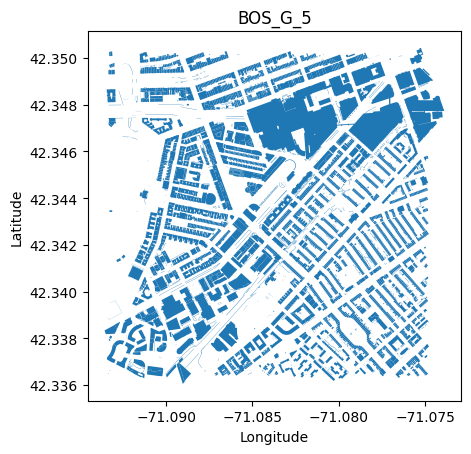

In [9]:
bostwin.plot_buildings(basemap=False)

and the corresponding 3D models be already previewed using the Sionna `preview`:

In [10]:
sionna_scene.preview()

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, position=(0.0, 0.0, …

#### Antennas

The second component of BostonTwin is the antennas around the city. The `scene_antennas` variable returned by the `load_bostontwin` method is a geopandas `GeoDataFrame` that contains all the information on the antennas in the area of the currently loaded scene.

In [11]:
n_antennas = scene_antennas.shape[0]
print(f"There are {n_antennas} antennas in the {scene_name} scene.")

There are 167 antennas in the BOS_G_5 scene.


Similarly to the 3D models, we can also show the location of the antennas in the scene:

<Axes: title={'center': 'BOS_G_5'}, xlabel='Longitude', ylabel='Latitude'>

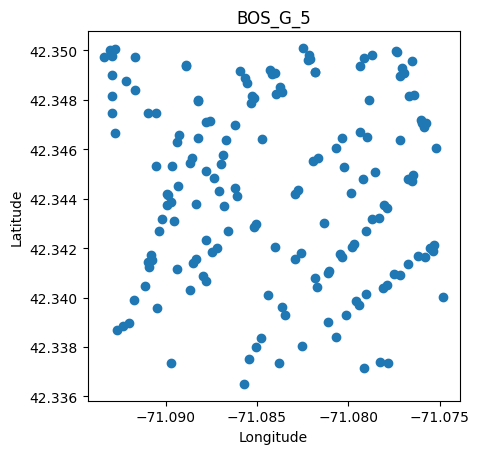

In [12]:
bostwin.plot_antennas(basemap=False)

Then, we need to spawn the antennas in the Sionna scene. We provide an example to do that, to be adjusted to one's need.

In [13]:
n_txs = 30  # number of transmitters
if n_txs>n_antennas:
    raise ValueError(f"There are {n_antennas} in the scene. Please select a number of transmitters lower than {n_antennas}")
n_rxs = n_antennas - n_txs  # set the antennas that are not transmitters to be receivers 

# select the antennas from scene_antennas using their indices 
ant_ids = np.arange(n_antennas)
tx_ids = np.sort(np.random.choice(ant_ids, size=n_txs, replace=False))  # pick n_txs random indices for the transmitters
rx_ids = np.setdiff1d(ant_ids,tx_ids)  # the rest are receivers 
print(f"Transmitter IDs: {tx_ids}\nReceivers IDs:{rx_ids}")

Transmitter IDs: [  6  10  15  19  31  34  37  41  53  56  62  74  82  92  93  95 110 115
 117 122 123 124 125 135 137 138 139 145 159 166]
Receivers IDs:[  0   1   2   3   4   5   7   8   9  11  12  13  14  16  17  18  20  21
  22  23  24  25  26  27  28  29  30  32  33  35  36  38  39  40  42  43
  44  45  46  47  48  49  50  51  52  54  55  57  58  59  60  61  63  64
  65  66  67  68  69  70  71  72  73  75  76  77  78  79  80  81  83  84
  85  86  87  88  89  90  91  94  96  97  98  99 100 101 102 103 104 105
 106 107 108 109 111 112 113 114 116 118 119 120 121 126 127 128 129 130
 131 132 133 134 136 140 141 142 143 144 146 147 148 149 150 151 152 153
 154 155 156 157 158 160 161 162 163 164 165]


Configure the transmitter and receiver antennas (see Sionna documentation and tutorials): 

In [14]:
# Configure antenna array for all transmitters
sionna_scene.tx_array = PlanarArray(num_rows=1,
                             num_cols=1,
                             vertical_spacing=0.5,
                             horizontal_spacing=0.5,
                             pattern="tr38901",
                             polarization="V")

# Configure antenna array for all receivers
sionna_scene.rx_array = PlanarArray(num_rows=1,
                             num_cols=1,
                             vertical_spacing=0.5,
                             horizontal_spacing=0.5,
                             pattern="dipole",
                             polarization="cross")

and add them as `Radio Devices` into the Sionna scene using the `add_scene_antennas` method: 

In [15]:
# remove existing Radio Devices
[sionna_scene.remove(tx) for tx in sionna_scene.transmitters]
[sionna_scene.remove(rx) for rx in sionna_scene.receivers]

# add the antennas to the BostonTwin
tx_rx_dict = bostwin.add_scene_antennas(tx_ids,rx_ids)

#### BostonTwin

All the elements of BostonTwin are now loaded, and we can plot it on the 2D geographic map

<Axes: title={'center': 'BOS_G_5'}, xlabel='Longitude', ylabel='Latitude'>

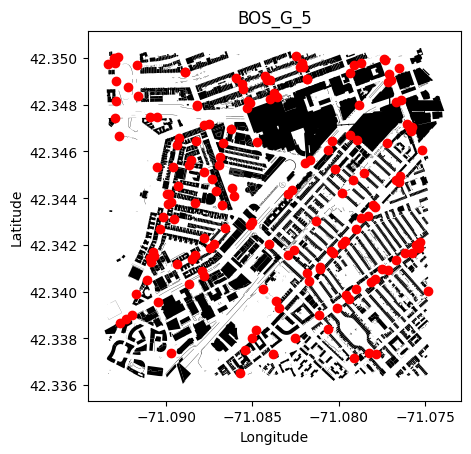

In [16]:
bostwin.plot_twin(basemap=False)

interact with the preview

In [17]:
sionna_scene.preview(show_devices=True)

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, matrixWorldNeedsUpda…

or rendered it from a camera, defined through the Sionna API  

Note: on CPU, the rendering might take a while and require several GBs of RAM, depending on the size and number of objects in the scene.

In [18]:
render_cam = Camera("render_cam",position=[-300, -500, 150])
sionna_scene.add(render_cam)
render_cam.look_at([500, 700, 0])

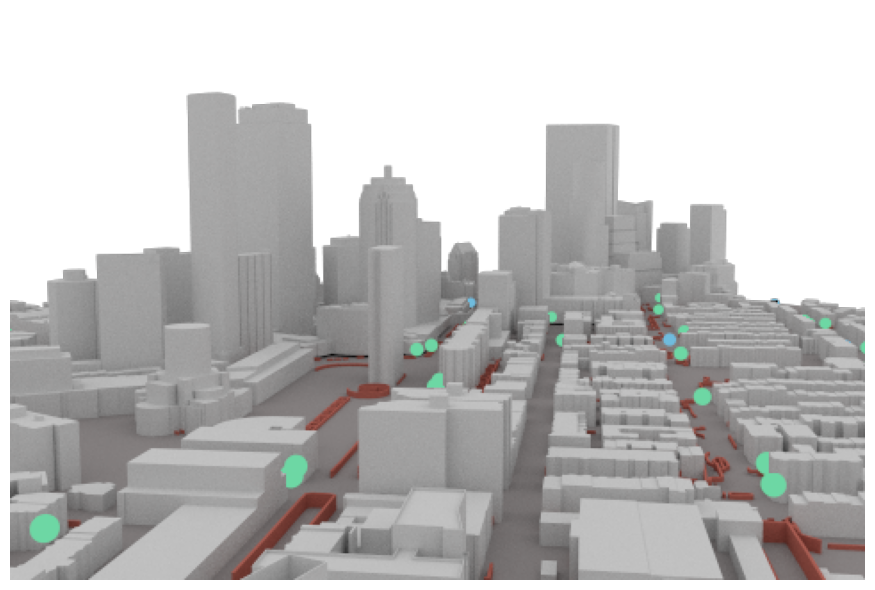

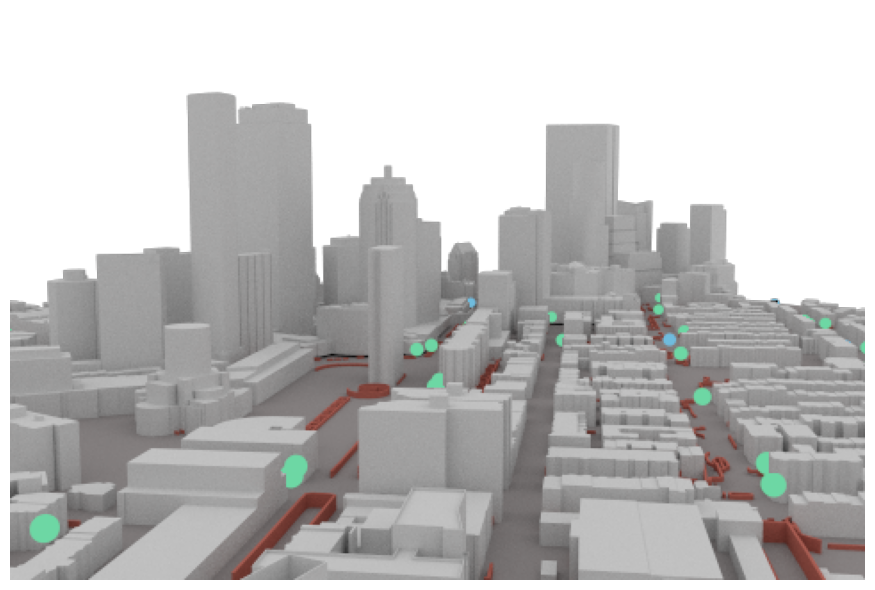

In [19]:
resolution = [480, 320]  # increase for higher quality of renderings
sionna_scene.render(render_cam, show_devices=True, resolution=resolution)